# Financial **Forecasting**

## Data preparation and **Setup**

In [1]:
# --- Imports ---
import yfinance as yf
from prophet import Prophet
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
import math
import numpy.random as npr

# --- Plot style ---
sns.set_theme(context="notebook", style="whitegrid")
plt.rcParams.update({
    "figure.figsize": (12, 6),
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "xtick.labelsize": 10,
    "ytick.labelsize": 10,
    "legend.frameon": False,
    "figure.autolayout": True,
})

# --- Date range for data extraction ---
start = "2015-09-30"
end   = "2025-09-30"

# --- Ticker -> Company name mapping ---
companies = {
    "NTDOY": "Nintendo Co., Ltd.",
    "SONY": "Sony Group Corporation",
    "MSFT":   "Microsoft Corporation",
    "EA":     "Electronic Arts Inc.",
    "TCEHY": "Tencent Holdings Corporation"
}


Ce bloc de code prépare l'environnement pour l'analyse et la visualisation de données financières. Il importe les bibliothèques nécessaires, configure les styles de traçage et définit des variables importantes pour l'extraction de données.

Dans le même temps, nous définissons les entreprises à étudier à savoir Nintendo (NTDOY) et ses concurrents (Nintendo Co., Ltd., Sony Group Corporation, Microsoft Corporation, Electronic Arts Inc., Tencent Holdings Corporation).

## Data Extraction and Historical Analysis

### Retrieving Financial Data

In [2]:
# ---------- 1) Détails financiers Nintendo ----------
ntd_ticker = "NTDOY"
ntd = yf.Ticker(ntd_ticker)

# Annual Financial Statements
balance_sheet = ntd.balance_sheet
income_stmt   = ntd.income_stmt
cashflow_stmt = ntd.cashflow

# Dividends
# Convertir les dates de début et de fin en objets datetime sensibles au fuseau horaire 'Asia/Tokyo'
# pour correspondre au fuseau horaire de l'index des dividendes.
start_ts = pd.to_datetime(start).tz_localize('Asia/Tokyo')
end_ts = pd.to_datetime(end).tz_localize('Asia/Tokyo')
div_all = ntd.dividends
div_period = div_all.loc[(div_all.index >= start_ts) & (div_all.index <= end_ts)]


# Affichages
print("=== NINTENDO (NTDOY) — Balance Sheet ===")
# Set display options to show all rows and columns
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
display(balance_sheet)
# Reset display options to default
pd.reset_option('display.max_columns')
pd.reset_option('display.max_rows')

print("\n=== NINTENDO (NTDOY) — Income Statement ===")
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
display(income_stmt)
pd.reset_option('display.max_columns')
pd.reset_option('display.max_rows')

print("\n=== NINTENDO (NTDOY) — Cash Flow Statement ===")
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
display(cashflow_stmt)
pd.reset_option('display.max_columns')
pd.reset_option('display.max_rows')

print("\n=== NINTENDO (NTDOY) — Dividends ===")
display(div_period.to_frame(name="Dividend per share"))



=== NINTENDO (NTDOY) — Balance Sheet ===


,2025-03-31,2024-03-31,2023-03-31,2022-03-31
Treasury Shares Number,1.344418e+08,1.344515e+08,1.344606e+08,1.254702e+08
Ordinary Shares Number,1.164248e+09,1.164238e+09,1.164229e+09,1.173220e+09
Share Issued,1.298690e+09,1.298690e+09,1.298690e+09,1.298690e+09
Tangible Book Value,2.700964e+12,2.587356e+12,2.247639e+12,2.051727e+12
Invested Capital,2.724326e+12,2.603761e+12,2.266234e+12,2.069042e+12
Working Capital,2.154706e+12,2.094026e+12,1.781033e+12,1.585486e+12
Net Tangible Assets,2.700964e+12,2.587356e+12,2.247639e+12,2.051727e+12
Common Stock Equity,2.724326e+12,2.603761e+12,2.266234e+12,2.069042e+12
Total Capitalization,2.724326e+12,2.603761e+12,2.266234e+12,2.069042e+12
Total Equity Gross Minority Interest,2.725445e+12,2.604998e+12,2.266466e+12,2.069308e+12



=== NINTENDO (NTDOY) — Income Statement ===


,2025-03-31,2024-03-31,2023-03-31,2022-03-31,2021-03-31
Tax Effect Of Unusual Items,3.765000e+06,6.277500e+07,-1.218000e+08,1.030339e+09,NaN
Tax Rate For Calcs,2.510000e-01,2.790000e-01,2.800000e-01,2.916330e-01,NaN
Normalized EBITDA,2.979000e+11,5.465730e+11,6.123540e+11,6.816640e+11,NaN
Total Unusual Items,1.500000e+07,2.250000e+08,-4.350000e+08,3.533000e+09,NaN
Total Unusual Items Excluding Goodwill,1.500000e+07,2.250000e+08,-4.350000e+08,3.533000e+09,NaN
Net Income From Continuing Operation Net Minority Interest,2.788060e+11,4.906020e+11,4.327680e+11,4.776910e+11,NaN
Reconciled Depreciation,1.536100e+10,1.785600e+10,1.104000e+10,1.052700e+10,NaN
Reconciled Cost Of Revenue,4.547540e+11,7.175300e+11,7.162370e+11,7.492990e+11,NaN
EBITDA,2.979150e+11,5.467980e+11,6.119190e+11,6.851970e+11,NaN
EBIT,2.825540e+11,5.289420e+11,6.008790e+11,6.746700e+11,NaN



=== NINTENDO (NTDOY) — Cash Flow Statement ===


,2025-03-31,2024-03-31,2023-03-31,2022-03-31,2021-03-31
Free Cash Flow,-6.939000e+09,4.459740e+11,3.006530e+11,2.820740e+11,NaN
Repurchase Of Capital Stock,NaN,NaN,-5.073300e+10,-9.535000e+10,-6.700000e+07
Capital Expenditure,-1.900800e+10,-1.612300e+10,-2.219000e+10,-7.587000e+09,NaN
End Cash Position,1.414121e+12,8.534320e+11,1.194569e+12,1.022718e+12,NaN
Other Cash Adjustment Outside Changein Cash,NaN,NaN,NaN,1.000000e+06,NaN
Beginning Cash Position,8.534320e+11,1.194569e+12,1.022718e+12,9.320790e+11,NaN
Effect Of Exchange Rate Changes,-9.317000e+09,6.435600e+10,2.847400e+10,4.428800e+10,NaN
Changes In Cash,5.700060e+11,-4.054930e+11,1.433770e+11,4.635000e+10,NaN
Financing Cash Flow,-1.951260e+11,-2.369580e+11,-2.909730e+11,-3.370100e+11,NaN
Net Other Financing Charges,-1.935000e+09,-7.180000e+08,-5.227300e+10,-1.100000e+09,NaN



=== NINTENDO (NTDOY) — Dividends ===


,Dividend per share
Date,
2024-09-30 00:00:00-04:00,0.058
2025-03-31 00:00:00-04:00,0.147


In [3]:
# ---------- 1) Détails financiers Nintendo ----------
ntd_ticker = "NTDOY"
ntd = yf.Ticker(ntd_ticker)

# Annual Financial Statements
balance_sheet = ntd.balance_sheet
income_stmt   = ntd.income_stmt
cashflow_stmt = ntd.cashflow

# Dividends
# Convertir les dates de début et de fin en objets datetime sensibles au fuseau horaire 'America/New_York'
# pour correspondre au fuseau horaire de l'index des dividendes.
start_ts = pd.to_datetime(start).tz_localize('America/New_York')
end_ts = pd.to_datetime(end).tz_localize('America/New_York')
div_all = ntd.dividends
div_period = div_all.loc[(div_all.index >= start_ts) & (div_all.index <= end_ts)]


# Affichages
print("=== NINTENDO (NTDOY) — Balance Sheet ===")
# Set display options to show all rows and columns
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
display(balance_sheet)
# Reset display options to default
pd.reset_option('display.max_columns')
pd.reset_option('display.max_rows')

print("\n=== NINTENDO (NTDOY) — Income Statement ===")
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
display(income_stmt)
pd.reset_option('display.max_columns')
pd.reset_option('display.max_rows')

print("\n=== NINTENDO (NTDOY) — Cash Flow Statement ===")
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
display(cashflow_stmt)
pd.reset_option('display.max_columns')
pd.reset_option('display.max_rows')

print("\n=== NINTENDO (NTDOY) — Dividends ===")
display(div_period.to_frame(name="Dividend per share"))

=== NINTENDO (NTDOY) — Balance Sheet ===


,2025-03-31,2024-03-31,2023-03-31,2022-03-31
Treasury Shares Number,1.344418e+08,1.344515e+08,1.344606e+08,1.254702e+08
Ordinary Shares Number,1.164248e+09,1.164238e+09,1.164229e+09,1.173220e+09
Share Issued,1.298690e+09,1.298690e+09,1.298690e+09,1.298690e+09
Tangible Book Value,2.700964e+12,2.587356e+12,2.247639e+12,2.051727e+12
Invested Capital,2.724326e+12,2.603761e+12,2.266234e+12,2.069042e+12
Working Capital,2.154706e+12,2.094026e+12,1.781033e+12,1.585486e+12
Net Tangible Assets,2.700964e+12,2.587356e+12,2.247639e+12,2.051727e+12
Common Stock Equity,2.724326e+12,2.603761e+12,2.266234e+12,2.069042e+12
Total Capitalization,2.724326e+12,2.603761e+12,2.266234e+12,2.069042e+12
Total Equity Gross Minority Interest,2.725445e+12,2.604998e+12,2.266466e+12,2.069308e+12



=== NINTENDO (NTDOY) — Income Statement ===


,2025-03-31,2024-03-31,2023-03-31,2022-03-31,2021-03-31
Tax Effect Of Unusual Items,3.765000e+06,6.277500e+07,-1.218000e+08,1.030339e+09,NaN
Tax Rate For Calcs,2.510000e-01,2.790000e-01,2.800000e-01,2.916330e-01,NaN
Normalized EBITDA,2.979000e+11,5.465730e+11,6.123540e+11,6.816640e+11,NaN
Total Unusual Items,1.500000e+07,2.250000e+08,-4.350000e+08,3.533000e+09,NaN
Total Unusual Items Excluding Goodwill,1.500000e+07,2.250000e+08,-4.350000e+08,3.533000e+09,NaN
Net Income From Continuing Operation Net Minority Interest,2.788060e+11,4.906020e+11,4.327680e+11,4.776910e+11,NaN
Reconciled Depreciation,1.536100e+10,1.785600e+10,1.104000e+10,1.052700e+10,NaN
Reconciled Cost Of Revenue,4.547540e+11,7.175300e+11,7.162370e+11,7.492990e+11,NaN
EBITDA,2.979150e+11,5.467980e+11,6.119190e+11,6.851970e+11,NaN
EBIT,2.825540e+11,5.289420e+11,6.008790e+11,6.746700e+11,NaN



=== NINTENDO (NTDOY) — Cash Flow Statement ===


,2025-03-31,2024-03-31,2023-03-31,2022-03-31,2021-03-31
Free Cash Flow,-6.939000e+09,4.459740e+11,3.006530e+11,2.820740e+11,NaN
Repurchase Of Capital Stock,NaN,NaN,-5.073300e+10,-9.535000e+10,-6.700000e+07
Capital Expenditure,-1.900800e+10,-1.612300e+10,-2.219000e+10,-7.587000e+09,NaN
End Cash Position,1.414121e+12,8.534320e+11,1.194569e+12,1.022718e+12,NaN
Other Cash Adjustment Outside Changein Cash,NaN,NaN,NaN,1.000000e+06,NaN
Beginning Cash Position,8.534320e+11,1.194569e+12,1.022718e+12,9.320790e+11,NaN
Effect Of Exchange Rate Changes,-9.317000e+09,6.435600e+10,2.847400e+10,4.428800e+10,NaN
Changes In Cash,5.700060e+11,-4.054930e+11,1.433770e+11,4.635000e+10,NaN
Financing Cash Flow,-1.951260e+11,-2.369580e+11,-2.909730e+11,-3.370100e+11,NaN
Net Other Financing Charges,-1.935000e+09,-7.180000e+08,-5.227300e+10,-1.100000e+09,NaN



=== NINTENDO (NTDOY) — Dividends ===


,Dividend per share
Date,
2024-09-30 00:00:00-04:00,0.058
2025-03-31 00:00:00-04:00,0.147


### Historical Analysis

/tmp/ipython-input-331212039.py:3: FutureWarning: YF.download() has changed argument auto_adjust default to True
  prices = yf.download(tickers, start=start, end=end, progress=False)["Close"] # Changed 'Adj Close' to 'Close'


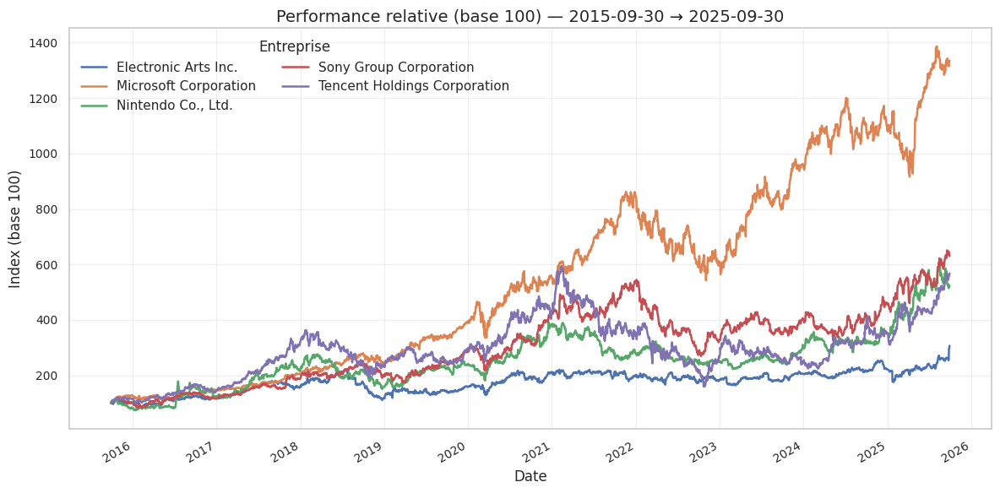

In [4]:
# ---------- 2) Historical Prices ----------
tickers = list(companies.keys())
prices = yf.download(tickers, start=start, end=end, progress=False)["Close"] # Changed 'Adj Close' to 'Close'

# Forcer DataFrame si un seul ticker
if isinstance(prices, pd.Series):
    prices = prices.to_frame()

# ---------- 3) Normalisation (base 100 au premier point valide) ----------
def base100(df: pd.DataFrame) -> pd.DataFrame:
    def norm_col(s):
        if s.dropna().empty:
            return s
        first_val = s.dropna().iloc[0]
        return (s / first_val) * 100.0
    return df.apply(norm_col, axis=0)

px_norm = base100(prices.copy())

# Renommer colonnes avec noms lisibles
px_norm = px_norm.rename(columns={t: companies.get(t, t) for t in px_norm.columns})

# ---------- 4) Visualisation performance relative ----------
ax = px_norm.plot(figsize=(12, 6), lw=1.8)
ax.set_title(f"Performance relative (base 100) — {start_ts.date()} → {end_ts.date()}")
ax.set_xlabel("Date")
ax.set_ylabel("Index (base 100)")
ax.grid(True, alpha=0.3)
plt.legend(title="Entreprise", ncol=2, frameon=False)
plt.show()

In [5]:
#Download stock data and calculating the returns

stocks = ['NTDOY', 'TCEHY', 'SONY', 'MSFT',"EA"]
prices = yf.download(stocks, start='2020-01-01', end='2024-12-31')['Close']
returns = prices.pct_change().dropna()

r = returns["NTDOY"].mean() #Calculate mean return
sigma = returns["NTDOY"].std() # std of returns

M = 100 #the number of time intervals for the discretization
T = 5.0
dt = T / M

I = 10000

S = np.zeros((M + 1, I))
S0 = prices["NTDOY"].loc["2024-12-30"]
S[0] = S0

for t in range(1, M + 1):
    S[t] = S[t-1] * np.exp((r - 0.5 * sigma ** 2) * dt + sigma * math.sqrt(dt) * npr.standard_normal(I))

# Using Plotly for interactive plot
import plotly.graph_objects as go

fig = go.Figure()

for i in range(I):
    fig.add_trace(go.Scatter(y=S[:, i], mode='lines', name=f'Simulation {i+1}', showlegend=False,
                             line=dict(width=1, color='lightblue')))

# Adding the mean trajectory for better visualization
fig.add_trace(go.Scatter(y=np.mean(S, axis=1), mode='lines', name='Mean Trajectory',
                         line=dict(width=2, color='darkblue')))

fig.update_layout(
    title='Monte Carlo Simulation of NTDOY Stock Price',
    xaxis_title='Time Step',
    yaxis_title='Stock Price',
    height=600,
    width=1000
)

fig.show()

/tmp/ipython-input-3095453512.py:4: FutureWarning: YF.download() has changed argument auto_adjust default to True
  prices = yf.download(stocks, start='2020-01-01', end='2024-12-31')['Close']
[*********************100%***********************]  5 of 5 completed


## Financial forecasting with Prophet
Time series analysis

In [6]:
import cmdstanpy, os

cmdstanpy.install_cmdstan(overwrite=True)
cmdstan_path = cmdstanpy.cmdstan_path()
os.environ["CMDSTAN"] = cmdstan_path

print(f"Prophet sera forcé à utiliser CmdStan depuis : {cmdstan_path}")

prophet_dir = "/usr/local/lib/python3.12/dist-packages/prophet/stan_model/cmdstan-2.33.1"
if os.path.exists(prophet_dir):
    import shutil
    print(f"Suppression de l'ancienne installation défectueuse : {prophet_dir}")
    shutil.rmtree(prophet_dir, ignore_errors=True)
else:
    print("Aucun ancien dossier cassé trouvé dans Prophet.")

print(f"\nCmdStan en cours : {cmdstanpy.cmdstan_path()}")

CmdStan install directory: /root/.cmdstan
Installing CmdStan version: 2.37.0
Download successful, file: /tmp/tmpfcbpvyh5
Extracting distribution
Unpacked download as cmdstan-2.37.0
Building version cmdstan-2.37.0, may take several minutes, depending on your system.
Installed cmdstan-2.37.0
Test model compilation
Prophet sera forcé à utiliser CmdStan depuis : /root/.cmdstan/cmdstan-2.37.0
Suppression de l'ancienne installation défectueuse : /usr/local/lib/python3.12/dist-packages/prophet/stan_model/cmdstan-2.33.1

CmdStan en cours : /root/.cmdstan/cmdstan-2.37.0


In [7]:
# Change the index column and rename it
income_stmt.reset_index(inplace=True)
income_stmt.rename(columns={'index':'Metric'}, inplace=True)

# Melt the DataFrame to transform date columns to the single 'Date' column
income_stmt = income_stmt.melt(id_vars=['Metric'], var_name='Date', value_name='Value')

# Convert 'Date' column to datetime format
income_stmt['Date'] = pd.to_datetime(income_stmt['Date'])

# Now, df has the required structure for Prophet
income_stmt

,Metric,Date,Value
0,Tax Effect Of Unusual Items,2025-03-31,3.765000e+06
1,Tax Rate For Calcs,2025-03-31,2.510000e-01
2,Normalized EBITDA,2025-03-31,2.979000e+11
3,Total Unusual Items,2025-03-31,1.500000e+07
4,Total Unusual Items Excluding Goodwill,2025-03-31,1.500000e+07
...,...,...,...
205,Operating Expense,2021-03-31,NaN
206,Gross Profit,2021-03-31,NaN
207,Cost Of Revenue,2021-03-31,NaN
208,Total Revenue,2021-03-31,NaN


In [8]:
# Create an empty DataFrame to store the forecasts for all metrics
all_forecasts = pd.DataFrame()

# Get unique metric names from the data
unique_metrics = income_stmt['Metric'].unique()

# Iterate through each unique metric and create forecasts
for metric in unique_metrics:
    # Select data for the specific metric
    metric_data = income_stmt[income_stmt['Metric'] == metric].drop(columns='Metric')

    # Rename columns to 'ds' and 'y' as strictly imposed by Prophet
    metric_data.rename(columns={'Date': 'ds', 'Value': 'y'}, inplace=True)

    # Create and fit the Prophet model
    prophet_model = Prophet()
    prophet_model.fit(metric_data)

    # Create a future dataframe for 5 years
    future = prophet_model.make_future_dataframe(periods=5*1, freq='Y')  # 5 years with yearly frequency

    # Make the forecast
    forecast = prophet_model.predict(future)

    # Add the forecasted values to the 'all_forecasts' DataFrame
    forecast['Metric'] = metric
    all_forecasts = pd.concat([all_forecasts, forecast[['ds', 'Metric', 'yhat', 'yhat_lower', 'yhat_upper']]])

# Prophet returns a large DataFrame with many interesting columns, but we subset our output to the columns most relevant to forecasting. These are:

# ds: the datestamp of the forecasted value
# yhat: the forecasted value of our metric (in Statistics, yhat is a notation traditionally used to represent the predicted values of a value y)
# yhat_lower: the lower bound of our forecasts
# yhat_upper: the upper bound of our forecasts

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 2.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning:

'Y' is deprecated and will be removed in a future version, please use 'YE' instead.

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 2.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning:

'Y' is deprecated and will be removed in a future version, please use 'YE' instead.

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:pro

In [9]:
# Display the forecasts for all metrics in millions
all_forecasts_millions = all_forecasts.copy()
all_forecasts_millions['yhat'] = all_forecasts_millions['yhat'] / 1_000_000
all_forecasts_millions['yhat_lower'] = all_forecasts_millions['yhat_lower'] / 1_000_000
all_forecasts_millions['yhat_upper'] = all_forecasts_millions['yhat_upper'] / 1_000_000

all_forecasts_millions

,ds,Metric,yhat,yhat_lower,yhat_upper
0,2021-03-31,Tax Effect Of Unusual Items,1.345895e+03,1.016931e+03,1.687938e+03
1,2022-03-31,Tax Effect Of Unusual Items,7.535194e+02,4.111632e+02,1.091298e+03
2,2023-03-31,Tax Effect Of Unusual Items,1.575588e+02,-1.923516e+02,4.907719e+02
3,2024-03-31,Tax Effect Of Unusual Items,3.265307e+02,-1.816762e+00,6.657828e+02
4,2025-03-31,Tax Effect Of Unusual Items,-2.620284e+02,-6.076737e+02,9.079726e+01
...,...,...,...,...,...
5,2025-12-31,Operating Revenue,1.630994e+06,1.508329e+06,1.746402e+06
6,2026-12-31,Operating Revenue,1.618867e+06,1.491596e+06,1.733498e+06
7,2027-12-31,Operating Revenue,1.598537e+06,1.478422e+06,1.717107e+06
8,2028-12-31,Operating Revenue,8.052556e+05,7.018847e+05,9.310185e+05


In [10]:
# Look at the projection of a specific metric
all_forecasts[all_forecasts['Metric'] == 'Total Revenue']

,ds,Metric,yhat,yhat_lower,yhat_upper
0,2021-03-31,Total Revenue,2.087436e+12,1.973207e+12,2.203635e+12
1,2022-03-31,Total Revenue,1.787448e+12,1.662828e+12,1.908288e+12
2,2023-03-31,Total Revenue,1.509461e+12,1.386110e+12,1.626546e+12
3,2024-03-31,Total Revenue,1.579299e+12,1.464802e+12,1.698862e+12
4,2025-03-31,Total Revenue,1.257424e+12,1.143653e+12,1.375839e+12
5,2025-12-31,Total Revenue,1.630994e+12,1.513732e+12,1.753404e+12
6,2026-12-31,Total Revenue,1.618867e+12,1.506098e+12,1.738031e+12
7,2027-12-31,Total Revenue,1.598537e+12,1.483450e+12,1.718511e+12
8,2028-12-31,Total Revenue,8.052556e+11,6.849468e+11,9.215110e+11
9,2029-12-31,Total Revenue,8.009823e+11,6.861009e+11,9.262088e+11


In [12]:
import plotly.graph_objects as go
import plotly.colors

# Filter forecasts for the three chosen metrics
chosen_metrics = ['Total Revenue', 'Total Expenses', 'Net Income']
chosen_metrics_forecasts = all_forecasts[all_forecasts['Metric'].isin(chosen_metrics)]

fig = go.Figure()

# Get a more vibrant color palette and define dash styles
colors = plotly.colors.qualitative.Vivid # Changed color palette
dash_styles = ['solid', 'dash', 'dot'] # Define distinct dash styles

for i, metric in enumerate(chosen_metrics):
    specific_metric_forecast = chosen_metrics_forecasts[chosen_metrics_forecasts['Metric'] == metric]

    # Assign a color and dash style for the current metric
    current_color = colors[i % len(colors)] # Cycle through colors
    current_dash = dash_styles[i % len(dash_styles)] # Cycle through dash styles

    # Add trace for the main forecast line
    fig.add_trace(go.Scatter(
        x=specific_metric_forecast['ds'],
        y=specific_metric_forecast['yhat'],
        mode='lines',
        name=f'{metric} Forecast',
        legendgroup=metric,
        line=dict(width=2, color=current_color, dash=current_dash), # Added dash style
        hovertemplate=f'<b>%{metric} Forecast</b>: %{{y:,.0f}}<br><b>Date</b>: %{{x|%Y-%m-%d}}<extra></extra>'
    ))

    # Add traces for the upper and lower bounds of the confidence interval
    # The upper bound is drawn first with an invisible line, then the lower bound
    # is drawn with fill='tonexty' to shade the area between them.
    fig.add_trace(go.Scatter(
        x=specific_metric_forecast['ds'],
        y=specific_metric_forecast['yhat_upper'],
        mode='lines',
        line=dict(width=0, color=current_color), # Invisible line
        showlegend=False,
        legendgroup=metric,
        name=f'{metric} Upper Bound'
    ))

    fig.add_trace(go.Scatter(
        x=specific_metric_forecast['ds'],
        y=specific_metric_forecast['yhat_lower'],
        mode='lines',
        line=dict(width=0, color=current_color), # Invisible line
        fill='tonexty', # Fill the area to the previous trace (yhat_upper)
        fillcolor='rgba(135, 206, 250, 0.2)', # Slightly adjusted light blue fill with transparency
        showlegend=False,
        legendgroup=metric,
        name=f'{metric} Lower Bound'
    ))

fig.update_layout(
    title={ 'text': '<b>Comparaison des prévisions financières</b>', 'x': 0.5, 'xanchor': 'center' }, # Centered and bold title
    xaxis_title='Date',
    yaxis_title='Valeur (en milliards)', # Updated y-axis label
    hovermode='x unified', # Enable unified hover mode for better interactivity
    height=600, # Adjust figure height
    width=1000, # Adjust figure width
    template='plotly_white', # Apply a clean white theme
    legend=dict(title='Métrique Financière', orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1) # Improved legend placement
)

fig.show()

# Scenario Analysis